In [1]:
import os
import heapq
import numpy as np
from warnings import warn
import scipy.spatial as spatial
import matplotlib.pyplot as plt
from bresenham import bresenham
from sklearn.neighbors import NearestNeighbors

In [2]:
def read_pgm(pgmf):
    with open( pgmf, 'rb' ) as f:
        """Return a raster of integers from a PGM as a list of lists."""
        header =  f.readline()
        print( header[0], header[1] )
        assert header == b'P5\n'
        while True:
            l = f.readline()
            if not l[0] == 35:   # skip any header comment lines
                break
        (width, height) = [int(i) for i in l.split()]
        depth = int(f.readline())
        assert depth <= 255

        raster = []
        for y in range(height):
            row = []
            for y in range(width):
                row.append(ord(f.read(1)))
            raster.append(row)

    return raster

r = read_pgm( '{}/sim_map.pgm'.format(os.getcwd()) )
b = np.flip(np.asarray(r),0)


80 53


In [3]:
# Waypoints
start = np.array([95,5])
waypoint = np.array([[45,50],[9,90],[90,10],[90,90]])

index = 0
for wp in waypoint:
    # Changing mapping due to numpy plotting behaviour
    wp[1] = b.shape[1]-wp[1]
    waypoint[index] = [wp[1],wp[0]]
    index += 1

# Maximum node distance
max_dst = 5

# Maximum Number of Iterations to Try
max_itrs = 10000


In [4]:
def rrt(start, end, max_itrs=10000, max_dst=5):
    path = np.array([start])
    path_idcs = np.array([0])
    # path = np.append(path,waypoint[0:2],axis=0)

    obst = np.where(b == 0)
    obst = np.asarray(list(zip(obst[0],obst[1])))

    # Collision Radius for Robot
    robt_dim = 5
    clsn_rad = robt_dim/2
    robt_pts = spatial.cKDTree(obst)
    

    itrs = 0
    while (np.where((path[:,0] == end[0]) & (path[:,1] == end[1]))[0].size == 0 and itrs <= max_itrs):
    # for _ in np.arange(100):
        smpl_fnd = False
        while not smpl_fnd:
            # Generate Random Sample
            i = np.random.randint(b.shape[0])
            j = np.random.randint(b.shape[1])

            # path = np.append(path,np.array([[i,j]]),axis=0)


            # Find the nearest node
            nbrs = NearestNeighbors(n_neighbors=1, algorithm='ball_tree').fit(path)
            distances, indices = nbrs.kneighbors(np.array([[i,j]]))

            if distances[0][0] > max_dst:
                # print('Original Path: {},{}'.format(np.int64(i), np.int64(j)))
                ang = np.arctan2((i-path[indices[0][0]][0]),(j-path[indices[0][0]][1]))
                i = path[indices[0][0]][0] + max_dst * np.sin(ang)
                j = path[indices[0][0]][1] + max_dst * np.cos(ang)
                # print('Angle: {}'.format(ang))
                # print('Trimmed Path: {},{}'.format(np.int64(i), np.int64(j)))

            l = list(bresenham(path[indices[0][0]][0],path[indices[0][0]][1], np.int64(i), np.int64(j)))

            clsn_flg = False
            ptfd_flg = False
            for coord in l:
                clsn = np.asarray(robt_pts.query_ball_point(coord, clsn_rad)).any()
                # print(np.asarray(l.path))
                # Checking for Obstacle Collision
                # if b[coord] == 0:
                if clsn:
                    # print('Collision Avoided at: {},{}'.format(coord[0],coord[1]))
                    clsn_flg = True
                    break
                elif (coord[0] == end[0] and coord[1] == end[1]):
                    # Path to Waypoint Found During Traversal
                    # print('Path Found from: ({},{}) to ({},{})'.format(start[0], start[1], end[0][0], end[0][1]))
                    # print(path.shape[0])
                    i = coord[0]
                    j = coord[1]
                    ptfd_flg = True
                    break
                # print(coord)
            if not clsn_flg:
                path = np.append(path,np.array([[np.int64(i), np.int64(j)]]),axis=0)   
                path_idcs = np.append(path_idcs,np.array([indices[0][-1]]),axis=0)   
                smpl_fnd = True 

            if ptfd_flg:
                break

        itrs += 1

    if itrs > max_itrs:
        print('Max Iterations Reached')
        return None, None
    else:
        print('Path Found from: ({},{}) to ({},{})'.format(start[0], start[1], end[0], end[1]))
        return path, path_idcs


# A*
Path Finding Algorithm
_Adapted from https://medium.com/@nicholas.w.swift/easy-a-star-pathfinding-7e6689c7f7b2_

In [5]:
class Node:
    """
    A node class for A* Pathfinding
    """

    def __init__(self, parent=None, position=None):
        self.parent = parent
        self.position = position

        self.g = 0
        self.h = 0
        self.f = 0

    def __eq__(self, other):
        return self.position == other.position
    
    def __repr__(self):
      return f"{self.position} - g: {self.g} h: {self.h} f: {self.f}"

    # defining less than for purposes of heap queue
    def __lt__(self, other):
      return self.f < other.f
    
    # defining greater than for purposes of heap queue
    def __gt__(self, other):
      return self.f > other.f




In [6]:
def return_path(current_node):
    path = []
    current = current_node
    while current is not None:
        path.append(current.position)
        current = current.parent
    return path[::-1]  # Return reversed path


def astar(maze, start, end, path, path_indices):
    """
    Returns a list of tuples as a path from the given start to the given end in the given maze
    :param maze:
    :param start:
    :param end:
    :return:
    """

    # Create start and end node
    start_node = Node(None, start)
    start_node.g = start_node.h = start_node.f = 0
    end_node = Node(None, end)
    end_node.g = end_node.h = end_node.f = 0

    # Initialize both open and closed list
    open_list = []
    closed_list = []

    # Heapify the open_list and Add the start node
    heapq.heapify(open_list) 
    heapq.heappush(open_list, start_node)

    # Adding a stop condition
    outer_iterations = 0
    max_iterations = (len(maze[0]) * len(maze) // 2)

    # Loop until you find the end
    while len(open_list) > 0:
        outer_iterations += 1
        # print(outer_iterations)

        if outer_iterations > max_iterations:
          # if we hit this point return the path such as it is
          # it will not contain the destination
          warn("giving up on pathfinding too many iterations")
          return return_path(current_node)       
        
        # Get the current node
        current_node = heapq.heappop(open_list)
        closed_list.append(current_node)

        # Found the goal
        if current_node == end_node:
            return return_path(current_node)

        # Generate children
        children = []

        # Finding the indices connected to the current node
        for indices in np.where((path[:,0] == current_node.position[0]) & (path[:,1] == current_node.position[1])):
            for index in indices:
                for coord in path[np.where(path_idcs == index)]:
                    new_position = coord

                    # Get node position
                    node_position = (new_position[0], new_position[1])

                    # Make sure within range
                    if node_position[0] > (len(maze) - 1) or node_position[0] < 0 or node_position[1] > (len(maze[len(maze)-1]) -1) or node_position[1] < 0:
                        continue

                    # Make sure walkable terrain
                    if maze[node_position[0]][node_position[1]] != 0:
                        continue

                    # Create new node
                    new_node = Node(current_node, node_position)

                    # Append
                    children.append(new_node)




        # Loop through children
        for child in children:
            # Child is on the closed list
            if len([closed_child for closed_child in closed_list if closed_child == child]) > 0:
                continue

            # Create the f, g, and h values
            child.g = current_node.g + 1
            child.h = ((child.position[0] - end_node.position[0]) ** 2) + ((child.position[1] - end_node.position[1]) ** 2)
            child.f = child.g + child.h

            # Child is already in the open list
            if len([open_node for open_node in open_list if child.position == open_node.position and child.g > open_node.g]) > 0:
                continue

            # Add the child to the open list
            heapq.heappush(open_list, child)

    warn("Couldn't get a path to destination")
    return None

In [7]:
def path_plan(start=(95,5), end=(70,15), path=None, path_indices=None, print_maze = True, maze = None):
    if path is not None:
        path = astar(maze, start, end, path=path, path_indices=path_indices)
        return np.asarray(path)

# Generating and Plotting the Path

The plot is overlaid with the nodes and the optimal path determined by A star.
Note that the path line's linewidth is increased, which may make it appear to collide with obstacles at times; this does not actually happen though.

In [8]:
def plot_figures(fig_num = 1, plt_cnct = True, plt_path = True):

    x = np.linspace(0, 100, b.shape[0])
    y = np.linspace(0, 100, b.shape[1])

    X, Y = np.meshgrid(x, y)
    plt.figure(fig_num)
    fig, ax = plt.subplots()

    plt.contourf(X, Y, b_star, 200, cmap='RdGy')
    plt.scatter(start[1], start[0],color='orange',s=20, zorder=3)
    plt.scatter(waypoint[:,1], waypoint[:,0],color='orange',s=20, zorder=3)
    if path.any() and plt_cnct:
        idx = 0
        for coord in path:
            plt.plot([coord[1], path[path_idcs[idx]][1]], [coord[0], path[path_idcs[idx]][0]], 'b-', linewidth=1, zorder=1)
            idx += 1
    if trv_path.any() and plt_path:
        plt.plot(trv_path[:,1], trv_path[:,0], 'g-', linewidth=4, zorder=2)




    plt.show()

In [9]:
path, path_idcs = rrt(start=start, end=waypoint[0], max_dst=20, max_itrs=20000)

if path is not None and path_idcs is not None:
    b_star = np.logical_not(b).astype(int)
    trv_path = path_plan(print_maze=True, maze=b_star, start=(start[0],start[1]), end=(waypoint[0][0],waypoint[0][1]), path=path, path_indices=path_idcs)

    if not trv_path.any():
        print('None')

Path Found from: (95,5) to (50,45)


<Figure size 432x288 with 0 Axes>

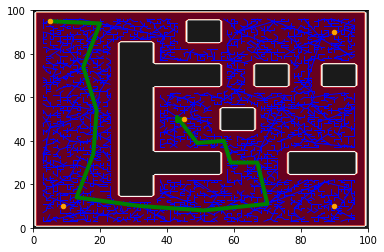

In [10]:
plot_figures(fig_num=1)

In [11]:
path, path_idcs = rrt(start=waypoint[0], end=waypoint[1], max_dst=20, max_itrs=20000)

if path is not None and path_idcs is not None:
    b_star = np.logical_not(b).astype(int)
    local_path = path_plan(print_maze=True, maze=b_star, start=(waypoint[0][0],waypoint[0][1]), end=(waypoint[1][0],waypoint[1][1]), path=path, path_indices=path_idcs)

    if local_path.any():
        trv_path = np.append(trv_path, local_path, axis=0)
        # trv_path = local_path
    else:
        print('None')


Path Found from: (50,45) to (10,9)


<Figure size 432x288 with 0 Axes>

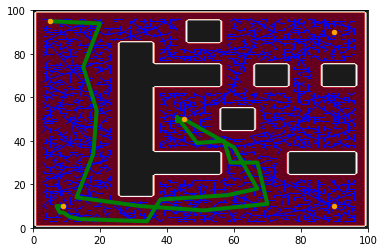

In [12]:
plot_figures(fig_num=2)

In [13]:
path, path_idcs = rrt(start=waypoint[1], end=waypoint[2], max_dst=20, max_itrs=20000)

if path is not None and path_idcs is not None:
    b_star = np.logical_not(b).astype(int)
    local_path = path_plan(print_maze=True, maze=b_star, start=(waypoint[1][0],waypoint[1][1]), end=(waypoint[2][0],waypoint[2][1]), path=path, path_indices=path_idcs)

    if local_path.any():
        trv_path = np.append(trv_path, local_path, axis=0)
        # trv_path = local_path
    else:
        print('None')


Path Found from: (10,9) to (90,90)


<Figure size 432x288 with 0 Axes>

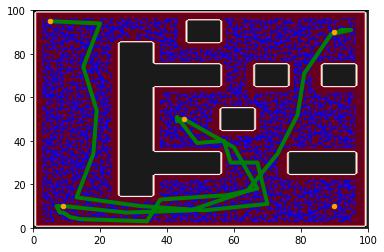

In [14]:
plot_figures(fig_num=3)

In [15]:
path, path_idcs = rrt(start=waypoint[2], end=waypoint[3], max_dst=20, max_itrs=20000)

if path is not None and path_idcs is not None:
    b_star = np.logical_not(b).astype(int)
    local_path = path_plan(print_maze=True, maze=b_star, start=(waypoint[2][0],waypoint[2][1]), end=(waypoint[3][0],waypoint[3][1]), path=path, path_indices=path_idcs)

    if local_path.any():
        trv_path = np.append(trv_path, local_path, axis=0)
        # trv_path = local_path
    else:
        print('None')


Path Found from: (90,90) to (10,90)


<Figure size 432x288 with 0 Axes>

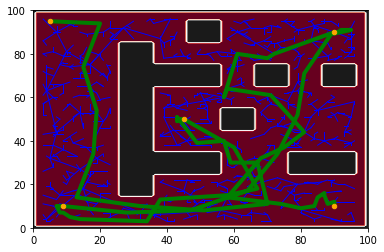

In [16]:
plot_figures(fig_num=4)